# PRCP-1013-WalkRunClass

- **Details:**
   - **Name:** Aditya Kashinath Rampurkar
   - **Project team's ID:** PTID-CDS-JAN-24-1741
   - **Batch Code:** 14-AUG-23-CDS-WDA16-PUN
   - **Registered Email ID:** adityarampurkar6@gmail.com
   - **Registration Number:** +91 9112497837

In [1]:
# Import important libraries
import pandas as pd
import numpy as np

# Import important libraries visualization
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# Libraries to split data into Train and Test Data
from sklearn.model_selection import train_test_split

# Import libraries to handle scaling
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# Library for statistical operations
from scipy import stats

# Import plotly express for creating interactive plots
import plotly.express as px

# Import models algorithms
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.neural_network import MLPClassifier

# Libraries to evaluate model
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Library to ignore warnings
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Load file with variable named as data
data = pd.read_csv('walkrun.csv')

In [3]:
# Display dataset
data

,date,time,username,wrist,activity,acceleration_x,acceleration_y,acceleration_z,gyro_x,gyro_y,gyro_z
0,2017-6-30,13:51:15:847724020,viktor,0,0,0.2650,-0.7814,-0.0076,-0.0590,0.0325,-2.9296
1,2017-6-30,13:51:16:246945023,viktor,0,0,0.6722,-1.1233,-0.2344,-0.1757,0.0208,0.1269
2,2017-6-30,13:51:16:446233987,viktor,0,0,0.4399,-1.4817,0.0722,-0.9105,0.1063,-2.4367
3,2017-6-30,13:51:16:646117985,viktor,0,0,0.3031,-0.8125,0.0888,0.1199,-0.4099,-2.9336
4,2017-6-30,13:51:16:846738994,viktor,0,0,0.4814,-0.9312,0.0359,0.0527,0.4379,2.4922
...,...,...,...,...,...,...,...,...,...,...,...
88583,2017-7-9,20:9:15:317911028,viktor,0,0,0.3084,-0.8376,-0.1327,0.4823,2.0124,0.6048
88584,2017-7-9,20:9:15:517889022,viktor,0,0,0.4977,-1.0027,-0.4397,0.1022,-1.2565,-0.0761
88585,2017-7-9,20:9:15:717828989,viktor,0,0,0.4587,-1.1780,-0.2827,-1.4500,-0.2792,-1.2616
88586,2017-7-9,20:9:15:917932987,viktor,0,0,0.2590,-0.8582,-0.0759,-1.5165,0.4560,-1.7755


# Basic Checks

In [4]:
# Show first 5 rows of data
data.head()

,date,time,username,wrist,activity,acceleration_x,acceleration_y,acceleration_z,gyro_x,gyro_y,gyro_z
0,2017-6-30,13:51:15:847724020,viktor,0,0,0.2650,-0.7814,-0.0076,-0.0590,0.0325,-2.9296
1,2017-6-30,13:51:16:246945023,viktor,0,0,0.6722,-1.1233,-0.2344,-0.1757,0.0208,0.1269
2,2017-6-30,13:51:16:446233987,viktor,0,0,0.4399,-1.4817,0.0722,-0.9105,0.1063,-2.4367
3,2017-6-30,13:51:16:646117985,viktor,0,0,0.3031,-0.8125,0.0888,0.1199,-0.4099,-2.9336
4,2017-6-30,13:51:16:846738994,viktor,0,0,0.4814,-0.9312,0.0359,0.0527,0.4379,2.4922


In [5]:
# Show last 5 rows of data
data.tail()

,date,time,username,wrist,activity,acceleration_x,acceleration_y,acceleration_z,gyro_x,gyro_y,gyro_z
88583,2017-7-9,20:9:15:317911028,viktor,0,0,0.3084,-0.8376,-0.1327,0.4823,2.0124,0.6048
88584,2017-7-9,20:9:15:517889022,viktor,0,0,0.4977,-1.0027,-0.4397,0.1022,-1.2565,-0.0761
88585,2017-7-9,20:9:15:717828989,viktor,0,0,0.4587,-1.1780,-0.2827,-1.4500,-0.2792,-1.2616
88586,2017-7-9,20:9:15:917932987,viktor,0,0,0.2590,-0.8582,-0.0759,-1.5165,0.4560,-1.7755
88587,2017-7-9,20:9:16:117410004,viktor,0,0,0.3140,-0.8008,-0.0911,0.1183,1.0850,1.2814


In [6]:
# Print shape of the dataset
print("Shape of the Data: ", data.shape)

Shape of the Data:  (88588, 11)


In [7]:
# It will show all details of data 
# Such as Data Types, Total entries, Total numbers of columns, 
# Null values and memory usage
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 88588 entries, 0 to 88587
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   date            88588 non-null  object 
 1   time            88588 non-null  object 
 2   username        88588 non-null  object 
 3   wrist           88588 non-null  int64  
 4   activity        88588 non-null  int64  
 5   acceleration_x  88588 non-null  float64
 6   acceleration_y  88588 non-null  float64
 7   acceleration_z  88588 non-null  float64
 8   gyro_x          88588 non-null  float64
 9   gyro_y          88588 non-null  float64
 10  gyro_z          88588 non-null  float64
dtypes: float64(6), int64(2), object(3)
memory usage: 7.4+ MB


In [8]:
# It will give all statistical information of columns having numerical data type
data.describe()

,wrist,activity,acceleration_x,acceleration_y,acceleration_z,gyro_x,gyro_y,gyro_z
count,88588.000000,88588.000000,88588.000000,88588.000000,88588.000000,88588.000000,88588.000000,88588.000000
mean,0.522170,0.500801,-0.074811,-0.562585,-0.313956,0.004160,0.037203,0.022327
std,0.499511,0.500002,1.009299,0.658458,0.486815,1.253423,1.198725,1.914423
min,0.000000,0.000000,-5.350500,-3.299000,-3.753800,-4.430600,-7.464700,-9.480000
25%,0.000000,0.000000,-0.381800,-1.033500,-0.376000,-0.920700,-0.644825,-1.345125
50%,1.000000,1.000000,-0.059500,-0.759100,-0.221000,0.018700,0.039300,0.006900
75%,1.000000,1.000000,0.355500,-0.241775,-0.085900,0.888800,0.733700,1.398200
max,1.000000,1.000000,5.603300,2.668000,1.640300,4.874200,8.498000,11.266200


# Observation

Acceleration (X, Y, Z):
1. The acceleration values along the X, Y, and Z axes have means close to zero, indicating that, on average, there is no consistent acceleration in any particular direction.
2. The standard deviations are relatively small, suggesting that the acceleration values are generally close to the mean.

Gyroscope (X, Y, Z):
1. The gyroscope readings along the X, Y, and Z axes also have means close to zero.
2. The standard deviations are larger compared to acceleration, indicating more variability in gyroscope readings.

In [9]:
# It will give all statistical information of columns having categorical data type
data.describe(include='O')

,date,time,username
count,88588,88588,88588
unique,12,88588,1
top,2017-7-16,13:51:15:847724020,viktor
freq,20480,1,88588


In [10]:
# Finding duplicates observations
data.duplicated().sum()

0

1. No Duplicate value

In [11]:
# Checking percentage of null values in each columns
(data.isnull().sum()/(len(data)))*100

date              0.0
time              0.0
username          0.0
wrist             0.0
activity          0.0
acceleration_x    0.0
acceleration_y    0.0
acceleration_z    0.0
gyro_x            0.0
gyro_y            0.0
gyro_z            0.0
dtype: float64

In [12]:
# Names of all columns
data.columns

Index(['date', 'time', 'username', 'wrist', 'activity', 'acceleration_x',
       'acceleration_y', 'acceleration_z', 'gyro_x', 'gyro_y', 'gyro_z'],
      dtype='object')

In [13]:
# Getting object dtype and finding their unique values.
for column in data.columns:
    if data[column].dtype == 'object':
        print(column.upper(),': ',data[column].nunique())
        print(data[column].value_counts().sort_values())
        print('\n')

DATE :  12
2017-7-4      3225
2017-7-7      3280
2017-7-2      3933
2017-6-30     3992
2017-7-1      4201
2017-7-10     4337
2017-7-11     6696
2017-7-9      7788
2017-7-15     7934
2017-7-6     11357
2017-7-17    11365
2017-7-16    20480
Name: date, dtype: int64


TIME :  88588
13:51:15:847724020    1
13:51:17:246767997    1
13:51:17:446569025    1
13:51:17:646152973    1
13:51:17:846502006    1
                     ..
20:9:12:517301976     1
20:9:12:317988991     1
20:9:12:117035984     1
20:9:14:917038023     1
20:9:16:117410004     1
Name: time, Length: 88588, dtype: int64


USERNAME :  1
viktor    88588
Name: username, dtype: int64




In [14]:
# Dropping 'date', 'time', and 'username' columns from the DataFrame 'data'
data.drop(['date','time','username'], axis = 1,inplace=True)

### Classifying activities into walk and run:

0 : Walk
1 : Run

In [15]:
print('Data contains ' + str(pd.value_counts(data['activity'].values)[0]) +
      ' "walk" data samples as well as ' + str(pd.value_counts(data['activity'].values)[1]) + 
      ' "run" data samples')

Data contains 44223 "walk" data samples as well as 44365 "run" data samples


#### Classifying wrist into left and right:
0 : left
1 : right

In [16]:
print('The data contains ' + str(pd.value_counts(data['wrist'].values)[0]) + 
      ' data samples collected on the left wrist as well as ' + str(pd.value_counts(data['wrist'].values)[1]) + 
      ' data samples collected on the right wrist')

The data contains 42330 data samples collected on the left wrist as well as 46258 data samples collected on the right wrist


## Univariant analysis

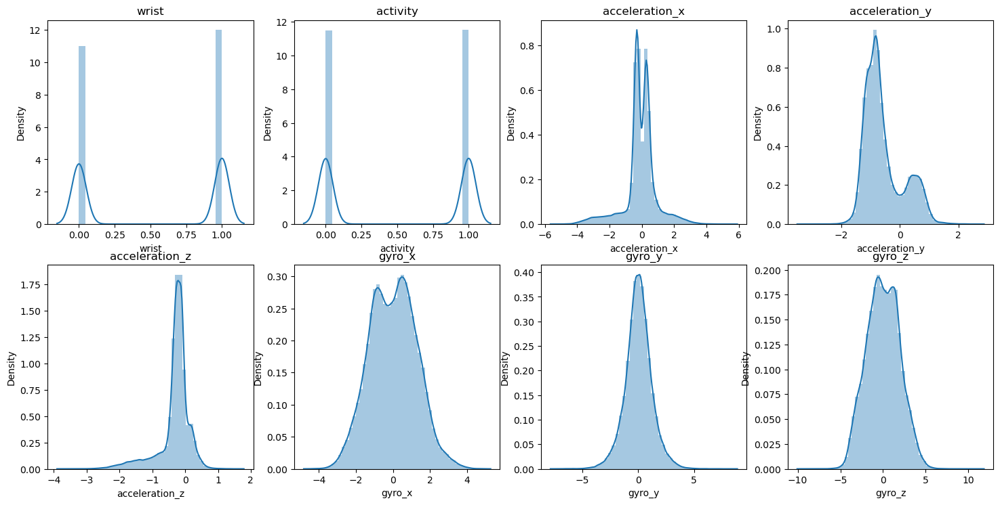

In [17]:
# Plotting the distribution of each column in 'data' using Seaborn
plt.figure(figsize=(18,18))
i=1
for x in data.columns:
    plt.subplot(4,4,i)
    sns.distplot(data[x])
    plt.title(x)
    i+=1

## Observation

1. Normal distribution is observed for acceleration_x and acceleration_y.
2. Acceleration_z data exhibits negative skewness.
3. Gyro_x, gyro_y, and gyro_z show normal distribution patterns.

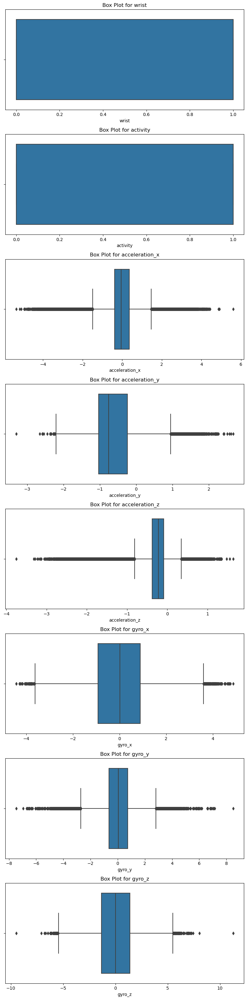

In [18]:
# Box plot
columns = data.columns

# Set up subplots for each column
fig, axes = plt.subplots(nrows=len(columns), ncols=1, figsize=(8, 4 * len(columns)))

# Loop through each column and create a box plot
for i, column in enumerate(columns):
    sns.boxplot(data=data, x=column, ax=axes[i])
    axes[i].set_title(f'Box Plot for {column}')

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()

#### Outlier found in:

1. Acceleration_x
2. Acceleration_y
3. Acceleration_z
4. gyro_x
5. gyro_y
6. gyro_z

# Bivariant analysis

In [19]:
Features = ['acceleration_x', 'acceleration_y', 'acceleration_z', 'gyro_x', 'gyro_y', 'gyro_z']

# populate dataframe with 'left' wrist only
df_left_wrist_data = pd.DataFrame()
df_left_wrist_data = data[data.wrist == 0]

# populate dataframe with 'right' wrist only
df_right_wrist_data = pd.DataFrame()
df_right_wrist_data = data[data.wrist == 1]

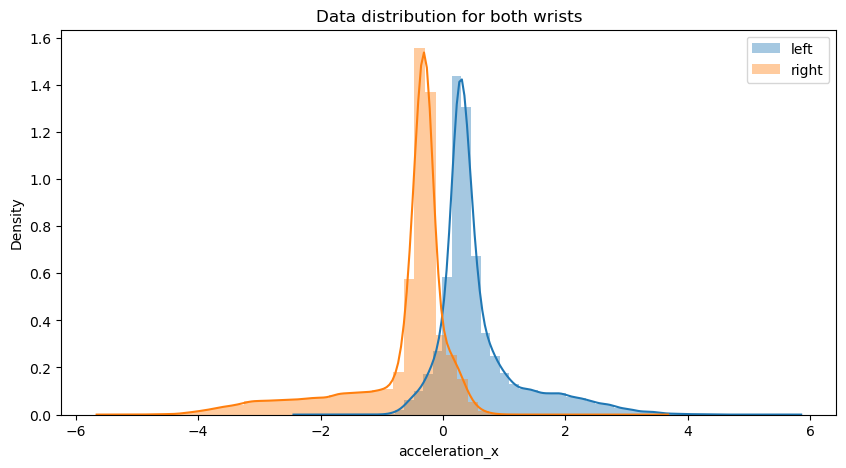

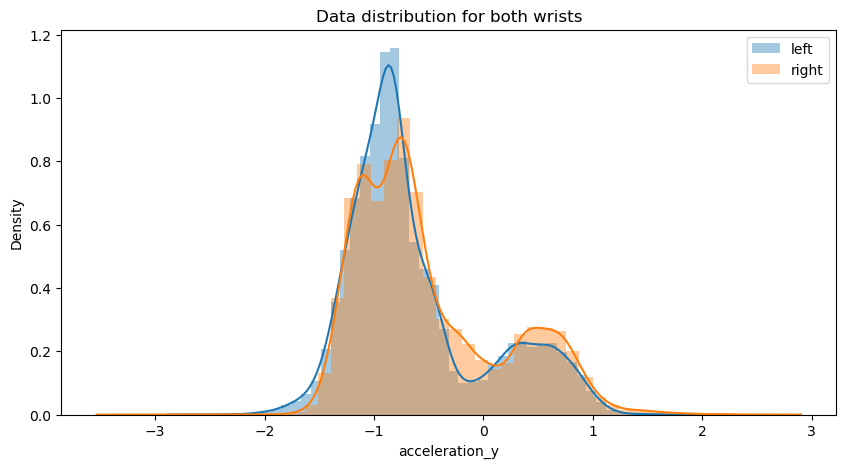

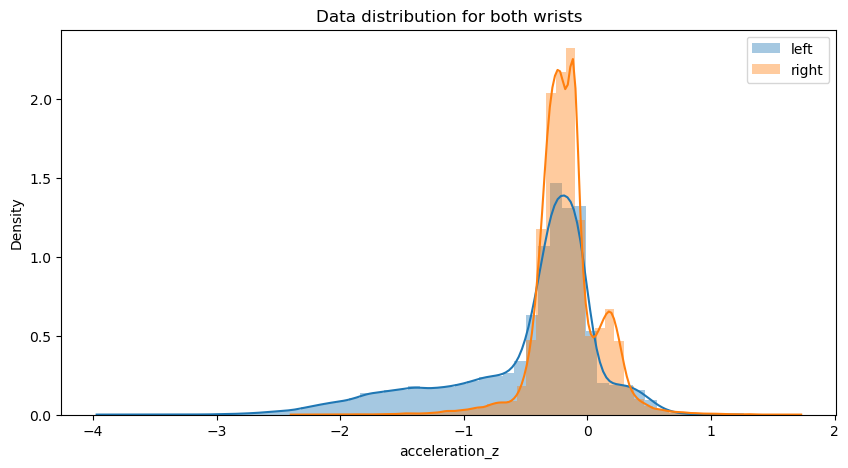

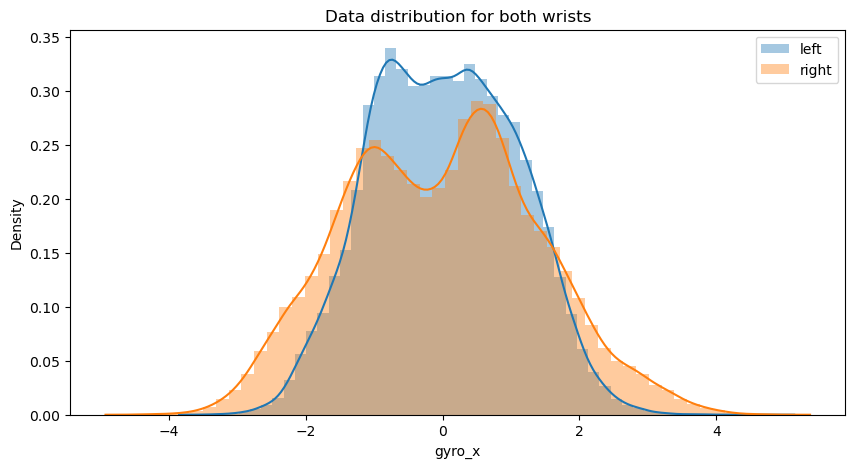

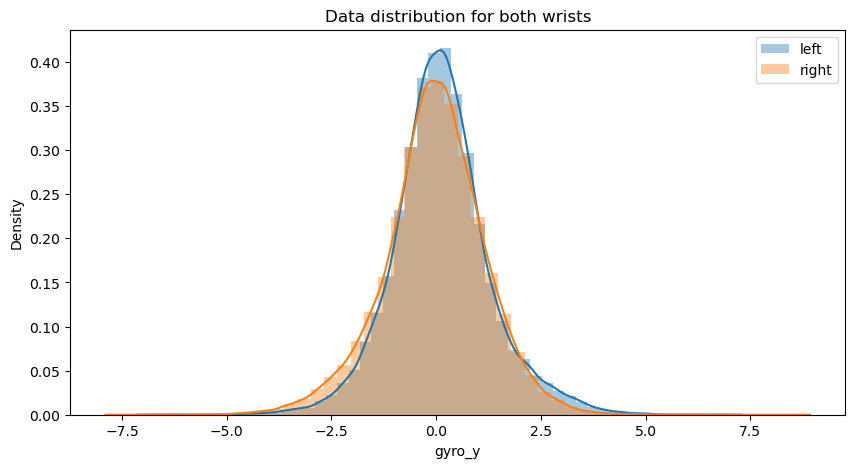

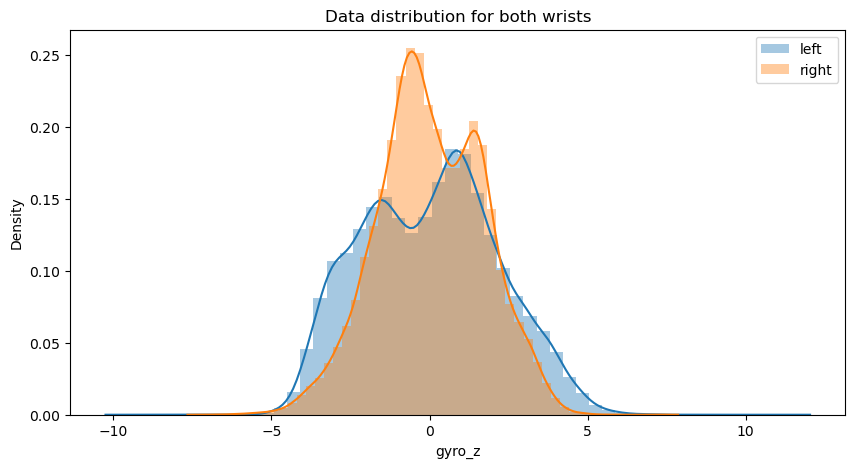

In [20]:
# Plotting the distribution of features in 'Features' for both left and right wrists using Seaborn
for c in Features:
    plt.figure(figsize=(10,5))
    plt.title("Data distribution for both wrists")
    sns.distplot(df_left_wrist_data[c], label='left')
    sns.distplot(df_right_wrist_data[c], label='right')
    plt.legend()
    plt.show()

# MultiVariant Analysis

In [21]:
# Create a 3D scatter plot using plotly express with acceleration data
fig = px.scatter_3d(data, x='acceleration_x', y='acceleration_y', 
                    z='acceleration_z', color='activity', color_continuous_scale='rdylbu')

# Show the plot
fig.show()

In [22]:
## Create a 3D scatter plot using plotly express with gyroscopic data
fig = px.scatter_3d(data, x='gyro_x', y='gyro_y', 
                    z='gyro_z', color='activity', color_continuous_scale='rdylbu')

# Show the plot
fig.show()

## Observation

1. Observing the acceleration data, instances with a value of 0 suggest walking, while those with a value of 1 indicate running.

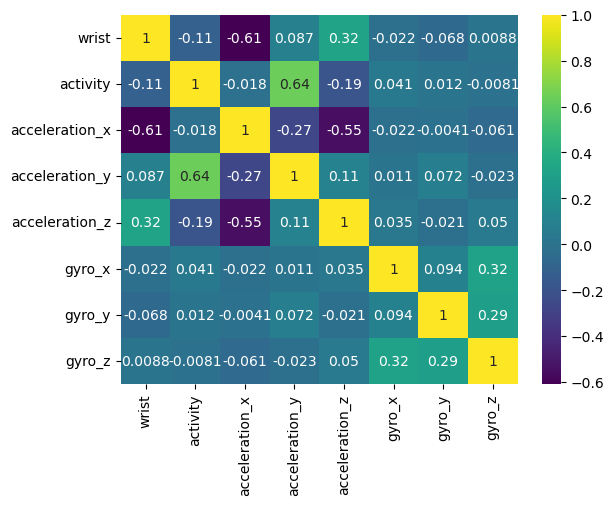

In [23]:
# Generating and displaying a heatmap to visualize the correlation matrix of the DataFrame 'data' using Seaborn
sns.heatmap(data.corr(), annot=True, cmap='viridis')
plt.show()

# Preprocessing

In [24]:
data.isnull().sum()

wrist             0
activity          0
acceleration_x    0
acceleration_y    0
acceleration_z    0
gyro_x            0
gyro_y            0
gyro_z            0
dtype: int64

In [25]:
data.duplicated().sum()

0

In [26]:
data

,wrist,activity,acceleration_x,acceleration_y,acceleration_z,gyro_x,gyro_y,gyro_z
0,0,0,0.2650,-0.7814,-0.0076,-0.0590,0.0325,-2.9296
1,0,0,0.6722,-1.1233,-0.2344,-0.1757,0.0208,0.1269
2,0,0,0.4399,-1.4817,0.0722,-0.9105,0.1063,-2.4367
3,0,0,0.3031,-0.8125,0.0888,0.1199,-0.4099,-2.9336
4,0,0,0.4814,-0.9312,0.0359,0.0527,0.4379,2.4922
...,...,...,...,...,...,...,...,...
88583,0,0,0.3084,-0.8376,-0.1327,0.4823,2.0124,0.6048
88584,0,0,0.4977,-1.0027,-0.4397,0.1022,-1.2565,-0.0761
88585,0,0,0.4587,-1.1780,-0.2827,-1.4500,-0.2792,-1.2616
88586,0,0,0.2590,-0.8582,-0.0759,-1.5165,0.4560,-1.7755


In [ ]:
# Handling outliers of all columns 
# find handling outliers using IQR?

In [27]:
# Calculate IQR for acceleration_x
IQR_acceleration_x = stats.iqr(data.acceleration_x, interpolation='midpoint')

# Calculate Q1 and Q3 for acceleration_x
Q1_acceleration_x = data.acceleration_x.quantile(0.25)
Q3_acceleration_x = data.acceleration_x.quantile(0.75)

# Set the limits for outliers for acceleration_x
min_limit_acceleration_x = Q1_acceleration_x - 1.5 * IQR_acceleration_x
max_limit_acceleration_x = Q3_acceleration_x + 1.5 * IQR_acceleration_x

# Replace outliers with the median value for acceleration_x
data.loc[(data.acceleration_x > max_limit_acceleration_x) | (data.acceleration_x < min_limit_acceleration_x), 'acceleration_x'] = np.median(data.acceleration_x)

# Replace negative values in acceleration_x with their absolute values
data.acceleration_x = np.abs(data.acceleration_x)

# Replace null values in acceleration_x with the median
data.acceleration_x.fillna(np.median(data.acceleration_x), inplace=True)

# Take the square root of acceleration_x
data.acceleration_x = np.sqrt(data.acceleration_x)

In [28]:
# Calculate IQR for acceleration_y
IQR_acceleration_y = stats.iqr(data.acceleration_y, interpolation='midpoint')

# Calculate Q1 and Q3 for acceleration_y
Q1_acceleration_y = data.acceleration_y.quantile(0.25)
Q3_acceleration_y = data.acceleration_y.quantile(0.75)

# Set the limits for outliers for acceleration_y
min_limit_acceleration_y = Q1_acceleration_y - 1.5 * IQR_acceleration_y
max_limit_acceleration_y = Q3_acceleration_y + 1.5 * IQR_acceleration_y

# Replace outliers with the median value for acceleration_y
data.loc[(data.acceleration_y > max_limit_acceleration_y) | (data.acceleration_y < min_limit_acceleration_y), 'acceleration_y'] = np.median(data.acceleration_y)

# Replace negative values in acceleration_y with their absolute values
data.acceleration_y = np.abs(data.acceleration_y)

# Replace null values in acceleration_y with the median
data.acceleration_y.fillna(np.median(data.acceleration_y), inplace=True)

# Take the square root of acceleration_y
data.acceleration_y = np.sqrt(data.acceleration_y)


In [29]:
# Calculate IQR for acceleration_z
IQR_acceleration_z = stats.iqr(data.acceleration_z, interpolation='midpoint')

# Calculate Q1 and Q3 for acceleration_z
Q1_acceleration_z = data.acceleration_z.quantile(0.25)
Q3_acceleration_z = data.acceleration_z.quantile(0.75)

# Set the limits for outliers for acceleration_z
min_limit_acceleration_z = Q1_acceleration_z - 1.5 * IQR_acceleration_z
max_limit_acceleration_z = Q3_acceleration_z + 1.5 * IQR_acceleration_z

# Replace outliers with the median value for acceleration_z
data.loc[(data.acceleration_z > max_limit_acceleration_z) | (data.acceleration_z < min_limit_acceleration_z), 'acceleration_z'] = np.median(data.acceleration_z)

# Replace negative values in acceleration_z with their absolute values
data.acceleration_z = np.abs(data.acceleration_z)

# Replace null values in acceleration_z with the median
data.acceleration_z.fillna(np.median(data.acceleration_z), inplace=True)

# Take the square root of acceleration_z
data.acceleration_z = np.sqrt(data.acceleration_z)

In [30]:
# Calculate IQR for gyro_x
IQR_gyro_x = stats.iqr(data.gyro_x, interpolation = 'midpoint')

# Calculate Q1 and Q3 for gyro_x
Q1_gyro_x = data.gyro_x.quantile(0.25)
Q3_gyro_x = data.gyro_x.quantile(0.75)

# Set the limits for outliers for gyro_x
min_limit_gyro_x = Q1_gyro_x - 1.5*IQR_gyro_x
max_limit_gyro_x = Q3_gyro_x + 1.5*IQR_gyro_x

# Replace outliers with the median value for gyro_x
data.loc[(data.gyro_x > max_limit_gyro_x) | (data.gyro_x < min_limit_gyro_x), 'gyro_x']=np.median(data.gyro_x)

In [31]:
# Calculate IQR for gyro_y
IQR_gyro_y = stats.iqr(data.gyro_y, interpolation='midpoint')

# Calculate Q1 and Q3 for gyro_y
Q1_gyro_y = data.gyro_y.quantile(0.25)
Q3_gyro_y = data.gyro_y.quantile(0.75)

# Set the limits for outliers for gyro_y
min_limit_gyro_y = Q1_gyro_y - 1.5 * IQR_gyro_y
max_limit_gyro_y = Q3_gyro_y + 1.5 * IQR_gyro_y

# Replace outliers with the median value for gyro_y
data.loc[(data.gyro_y > max_limit_gyro_y) | (data.gyro_y < min_limit_gyro_y), 'gyro_y'] = np.median(data.gyro_y)

# Replace negative values in gyro_y with their absolute values
data.gyro_y = np.abs(data.gyro_y)

# Replace null values in gyro_y with the median
data.gyro_y.fillna(np.median(data.gyro_y), inplace=True)

# Take the square root of gyro_y
data.gyro_y = np.sqrt(data.gyro_y)

In [32]:
# Calculate IQR for gyro_z
IQR_gyro_z = stats.iqr(data.gyro_z, interpolation='midpoint')

# Calculate Q1 and Q3 for gyro_z
Q1_gyro_z = data.gyro_z.quantile(0.25)
Q3_gyro_z = data.gyro_z.quantile(0.75)

# Set the limits for outliers for gyro_z
min_limit_gyro_z = Q1_gyro_z - 1.5 * IQR_gyro_z
max_limit_gyro_z = Q3_gyro_z + 1.5 * IQR_gyro_z

# Replace outliers with the median value for gyro_z
data.loc[(data.gyro_z > max_limit_gyro_z) | (data.gyro_z < min_limit_gyro_z), 'gyro_z'] = np.median(data.gyro_z)

In [33]:
## Columns Needed Scaling
scaling = data[['acceleration_x', 'acceleration_y', 'acceleration_z', 'gyro_x', 'gyro_y', 'gyro_z']]

In [34]:
scaling

,acceleration_x,acceleration_y,acceleration_z,gyro_x,gyro_y,gyro_z
0,0.514782,0.883968,0.087178,-0.0590,0.180278,-2.9296
1,0.819878,1.059858,0.484149,-0.1757,0.144222,0.1269
2,0.663250,1.217251,0.268701,-0.9105,0.326037,-2.4367
3,0.550545,0.901388,0.297993,0.1199,0.640234,-2.9336
4,0.693830,0.964987,0.189473,0.0527,0.661740,2.4922
...,...,...,...,...,...,...
88583,0.555338,0.915205,0.364280,0.4823,1.418591,0.6048
88584,0.705479,1.001349,0.663099,0.1022,1.120937,-0.0761
88585,0.677274,1.085357,0.531695,-1.4500,0.528394,-1.2616
88586,0.508920,0.926391,0.275500,-1.5165,0.675278,-1.7755


In [35]:
# Standard Scaler
scaler = StandardScaler()

# Fit the scaler to the data and transform the data
walk_run_data = scaler.fit_transform(scaling)

datas = pd.DataFrame(walk_run_data, columns=['acceleration_x','acceleration_y',
                                             'acceleration_z','gyro_x','gyro_y','gyro_z'])

In [36]:
# Applying scaling to all columns

# Initialize MinMaxScaler
scaler = MinMaxScaler()

# Apply MinMaxScaler to the data and store the result in the same variable
min_max_scaler = scaler.fit_transform(datas)

final_scaled = pd.DataFrame(min_max_scaler, columns=['acceleration_x','acceleration_y',
                                             'acceleration_z','gyro_x','gyro_y','gyro_z'])

In [37]:
final_scaled

,acceleration_x,acceleration_y,acceleration_z,gyro_x,gyro_y,gyro_z
0,0.422065,0.595579,0.096799,0.493709,0.107711,0.228229
1,0.672212,0.714086,0.537578,0.477554,0.086169,0.508057
2,0.543793,0.820130,0.298354,0.375839,0.194799,0.273355
3,0.451388,0.607315,0.330879,0.518473,0.382524,0.227863
4,0.568866,0.650166,0.210383,0.509171,0.395374,0.724604
...,...,...,...,...,...,...
88583,0.455317,0.616625,0.404481,0.568638,0.847573,0.551809
88584,0.578417,0.674665,0.736277,0.516023,0.669733,0.489472
88585,0.555292,0.731266,0.590372,0.301159,0.315702,0.380937
88586,0.417260,0.624161,0.305903,0.291953,0.403462,0.333889


In [38]:
# Separating target and independent variables
X = datas                    # Independent variables 
y = data[['activity']]       # Target variable

In [39]:
# Splitting the data into Train and Test data
# Train data will be used to train model
# Test data will be used to check trained model and to evaulate the model
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2, 
                                                    random_state=42)

In [40]:
# Checking independent variables of training dataset
X_train

,acceleration_x,acceleration_y,acceleration_z,gyro_x,gyro_y,gyro_z
37105,0.449528,0.518815,-0.416061,0.416686,-1.690236,-0.707455
54378,-1.305866,-0.554165,0.053719,0.017128,2.226165,1.253777
86477,0.600269,-2.730328,0.053719,-0.150014,-1.315093,-0.056536
84774,-1.641886,-0.846368,-0.877753,1.493940,-0.498571,0.458198
19425,1.063045,-0.855737,-2.331871,0.364338,0.050495,-0.097175
...,...,...,...,...,...,...
6265,-0.579686,0.657946,0.068311,-1.200933,-1.029823,0.886020
54886,0.665718,0.795437,-0.224203,0.821737,0.528275,1.697233
76820,0.163782,0.316038,-1.416797,-0.549733,-1.429560,-0.717772
860,0.617228,-0.464519,-1.446406,0.336306,-0.140332,0.341017


In [41]:
# This dataset will be used to evaluate trained model and with actual output
X_test 

,acceleration_x,acceleration_y,acceleration_z,gyro_x,gyro_y,gyro_z
57800,-1.305866,-0.772137,0.053719,0.241223,1.201228,-0.902546
53690,-0.910811,-0.973374,0.007399,1.418569,0.234501,1.883955
75294,-1.305866,2.206275,0.053719,-0.120851,-0.636802,1.444657
16113,-1.327087,-0.515488,-0.594793,0.606690,-1.570723,1.072057
88456,0.213384,1.247522,0.880835,-0.647159,0.237200,-0.735302
...,...,...,...,...,...,...
59702,-2.133868,-0.590540,0.245556,-0.667032,0.993160,-0.214041
68460,-1.002574,0.265885,-0.133043,1.253285,0.992818,0.725777
49049,-1.305866,0.146714,-0.616954,2.347020,1.881152,1.476979
51218,-0.439806,-0.781602,-0.546736,-0.621873,-1.348172,-0.464880


In [42]:
# Checking shape of training dataset
print("Shape of training dataset is: ", X_train.shape)

Shape of training dataset is:  (70870, 6)


In [43]:
# Checking the number of observations which supports "yes" or "no" category
y_train.value_counts()

activity
1           35560
0           35310
dtype: int64

# Logistic Regression

In [44]:
# Initialize the logistic regression model
model = LogisticRegression()

# Fit the model on the training dataset
model.fit(X_train, y_train)

LogisticRegression()

In [45]:
# Make predictions on the test data
y_pred_log = model.predict(X_test)

In [46]:
# Evaluation matrics to evaluate trained model on test dataset
accuracy = accuracy_score(y_test, y_pred_log)
conf_matrix = confusion_matrix(y_test, y_pred_log)
class_report = classification_report(y_test, y_pred_log)

print(f"Accuracy: {accuracy:.2f}")
print("Confusion Matrix:")
print(conf_matrix)
print("Classification Report:")
print(class_report)

Accuracy: 0.79
Confusion Matrix:
[[7306 1607]
 [2048 6757]]
Classification Report:
              precision    recall  f1-score   support

           0       0.78      0.82      0.80      8913
           1       0.81      0.77      0.79      8805

    accuracy                           0.79     17718
   macro avg       0.79      0.79      0.79     17718
weighted avg       0.79      0.79      0.79     17718



# Decision Tree

In [47]:
# Initialise the model objective
dt = DecisionTreeClassifier()

# Fit the model
dt.fit(X_train, y_train)

DecisionTreeClassifier()

In [48]:
# Predict the output for test dataset
y_pred_tree = dt.predict(X_test)

In [49]:
accuracy = accuracy_score(y_test, y_pred_tree)
conf_matrix = confusion_matrix(y_test, y_pred_tree)
class_report = classification_report(y_test, y_pred_tree)

print(f"Accuracy: {accuracy:.2f}")
print("\nConfusion Matrix:\n")
print(conf_matrix)
print("\nClassification Report:\n")
print(class_report)

Accuracy: 0.94

Confusion Matrix:

[[8326  587]
 [ 479 8326]]

Classification Report:

              precision    recall  f1-score   support

           0       0.95      0.93      0.94      8913
           1       0.93      0.95      0.94      8805

    accuracy                           0.94     17718
   macro avg       0.94      0.94      0.94     17718
weighted avg       0.94      0.94      0.94     17718



In [50]:
%%time
# Print time taken to execute this cell

# Dictionary of parameter to try and test for decision tree 
params = {
    "criterion":("gini", "entropy"), 
    "splitter":("best", "random"), 
    "max_depth":(list(range(1, 20))), 
    "min_samples_split":[2, 3, 4, 5, 6, 7],     
    "min_samples_leaf":list(range(1, 10))
    
}


tree_clf = DecisionTreeClassifier(random_state=3)
tree_cv = GridSearchCV(tree_clf, params, 
                       scoring="accuracy",           # Evaluation metric to evaluate the model
                       n_jobs=-1,                    # Numbers of cores used to execute this code
                       verbose=1, cv=3)

# Fit the model with each parameters
tree_cv.fit(X_train, y_train)

# It will print Best Parameters
best_params = tree_cv.best_params_ 
print(f"Best paramters: {best_params})")

Fitting 3 folds for each of 4104 candidates, totalling 12312 fits
Best paramters: {'criterion': 'entropy', 'max_depth': 18, 'min_samples_leaf': 9, 'min_samples_split': 2, 'splitter': 'best'})
CPU times: total: 1min 37s
Wall time: 8min 39s


In [63]:
# Passing best parameter to decision tree
dt1 = DecisionTreeClassifier(criterion='entropy', max_depth=18, min_samples_leaf= 9, min_samples_split=2, splitter='best')

# Training model with best parameter
dt1.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=18, min_samples_leaf=9)

In [64]:
# Predicton using Decision Tree
y_pred_hyper_decision = dt1.predict(X_test)

In [65]:
# Evaluation matrics to evaluate trained model on test dataset
accuracy = accuracy_score(y_test, y_pred_hyper_decision)
conf_matrix = confusion_matrix(y_test, y_pred_hyper_decision)
class_report = classification_report(y_test, y_pred_hyper_decision)

print(f"Accuracy: {accuracy:.2f}")
print("\nConfusion Matrix:\n")
print(conf_matrix)
print("\nClassification Report:\n")
print(class_report)

Accuracy: 0.95

Confusion Matrix:

[[8491  422]
 [ 472 8333]]

Classification Report:

              precision    recall  f1-score   support

           0       0.95      0.95      0.95      8913
           1       0.95      0.95      0.95      8805

    accuracy                           0.95     17718
   macro avg       0.95      0.95      0.95     17718
weighted avg       0.95      0.95      0.95     17718



# Random Forest 

In [54]:
# Object creation, taking 200 decision tree in random forest 
rf_clf = RandomForestClassifier(n_estimators=200) 

# Training model
rf_clf.fit(X_train,y_train)

RandomForestClassifier(n_estimators=200)

In [55]:
# Prediction using Random Forest Algorithm
y_pred_forest = rf_clf.predict(X_test)

In [56]:
# Evaluation matrics to evaluate trained model on test dataset
accuracy = accuracy_score(y_test, y_pred_forest)
conf_matrix = confusion_matrix(y_test, y_pred_forest)
class_report = classification_report(y_test, y_pred_forest)

print(f"Accuracy: {accuracy:.2f}")
print("\nConfusion Matrix:\n")
print(conf_matrix)
print("\nClassification Report:\n")
print(class_report)

Accuracy: 0.96

Confusion Matrix:

[[8608  305]
 [ 321 8484]]

Classification Report:

              precision    recall  f1-score   support

           0       0.96      0.97      0.96      8913
           1       0.97      0.96      0.96      8805

    accuracy                           0.96     17718
   macro avg       0.96      0.96      0.96     17718
weighted avg       0.96      0.96      0.96     17718



# XGradientboosting

In [57]:
# Initialize the XGBClassifier with specified parameters
xgb = XGBClassifier(random_state=42, verbosity=0, silent=0)

# Fit the model to the training data
xgb.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

In [58]:
# Prediction using XGradientboosting Algorithm
Y_pred_xgb = xgb.predict(X_test)

In [59]:
# Evaluation matrics to evaluate trained model on test dataset
accuracy = accuracy_score(y_test, Y_pred_xgb)
conf_matrix = confusion_matrix(y_test, Y_pred_xgb)
class_report = classification_report(y_test, Y_pred_xgb)

print(f"Accuracy: {accuracy:.2f}")
print("\nConfusion Matrix:\n")
print(conf_matrix)
print("\nClassification Report:\n")
print(class_report)

Accuracy: 0.97

Confusion Matrix:

[[8643  270]
 [ 321 8484]]

Classification Report:

              precision    recall  f1-score   support

           0       0.96      0.97      0.97      8913
           1       0.97      0.96      0.97      8805

    accuracy                           0.97     17718
   macro avg       0.97      0.97      0.97     17718
weighted avg       0.97      0.97      0.97     17718



# ANN

In [60]:
# Initialize the MLPClassifier with specified parameters
model = MLPClassifier( hidden_layer_sizes=(50,3),
                       learning_rate_init=0.1,
                       max_iter=100,
                       random_state=2) ## model object creation max_iter=Stopping parameter
model.fit(X_train,y_train) ## training the data

MLPClassifier(hidden_layer_sizes=(50, 3), learning_rate_init=0.1, max_iter=100,
              random_state=2)

In [61]:
# Prediction using ANN Algorithm
y_predict_ann = model.predict(X_test)

In [62]:
# Evaluation matrics to evaluate trained model on test dataset
accuracy = accuracy_score(y_test, y_predict_ann)
conf_matrix = confusion_matrix(y_test, y_predict_ann)
class_report = classification_report(y_test, y_predict_ann)

print(f"Accuracy: {accuracy:.2f}")
print("\nConfusion Matrix:\n")
print(conf_matrix)
print("\nClassification Report:\n")
print(class_report)

Accuracy: 0.95

Confusion Matrix:

[[8473  440]
 [ 420 8385]]

Classification Report:

              precision    recall  f1-score   support

           0       0.95      0.95      0.95      8913
           1       0.95      0.95      0.95      8805

    accuracy                           0.95     17718
   macro avg       0.95      0.95      0.95     17718
weighted avg       0.95      0.95      0.95     17718



## Observation for walk and run data



## Analysis:

1. The XGradient Boosting algorithm demonstrates the highest overall performance with the highest accuracy of 0.97 and strong precision, recall, and F1-Score for Class 1.

2. Random Forest and the hypertuned Decision Tree also exhibit robust performance, achieving high accuracy and precision for Class 1.

3. Logistic Regression, while providing a reasonable accuracy of 0.79, shows slightly lower precision and recall for Class

4. The Decision Tree model, with hyperparameter tuning, shows improved performance compared to the non-tuned version.

5. The Artificial Neural Network (ANN) achieves consistent performance with an accuracy of 0.95 and balanced precision, recall, and F1-Score for Class 

##  Recommendations

1. Consider XGradient Boosting as the primary algorithm for this classification task due to its high overall performance.

2. Evaluate Random Forest and hypertuned Decision Tree models for specific use cases where interpretability is crucial.

| Algorithm	                   | Accuracy	  | Precision(Class 1)	  | Recall (Class 1)	| F1-Score (Class 1)
|------------------------------|--------------|-----------------------|----------------------|------------------|
Logistic Regression |	0.79	| 0.81	| 0.77	| 0.79
|------------------------------|--------------|-----------------------|----------------------|------------------|
Decision Tree (No Hypertuning)	| 0.94	| 0.93	| 0.95	| 0.94
|------------------------------|--------------|-----------------------|----------------------|------------------|
Decision Tree (Hypertuned)	| 0.95	| 0.95	| 0.95	| 0.95
------------------------------|--------------|-----------------------|----------------------|------------------|
Random Forest 	| 0.96	| 0.97	| 0.96	| 0.96
|------------------------------|--------------|-----------------------|----------------------|------------------|
XGradient Boosting	| 0.97	| 0.97	| 0.96	| 0.97
|------------------------------|--------------|-----------------------|----------------------|------------------|
ANN 	| 0.95	| 0.95	| 0.95	| 0.95
|------------------------------|--------------|-----------------------|----------------------|------------------|

<div style="text-align: center; font-family: 'Your Preferred Font', cursive; font-size: 40px; color: purple; max-width: 100%; margin: 0 auto;">Thank You</div>